In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

import logging
import sys

def setup_logging(epoch_key, date_format='%d-%b-%y %H:%M:%S', format='%(asctime)s %(message)s'):
    animal, day, epoch = epoch_key
    log_filename = f"{animal}_{day:02d}_{epoch:02d}.log"

    logger = logging.getLogger()
    logger.setLevel(logging.INFO)
    formatter = logging.Formatter(fmt=format, datefmt=date_format)

    stdout_handler = logging.StreamHandler(sys.stdout)
    stdout_handler.setLevel(logging.INFO)
    stdout_handler.setFormatter(formatter)

    file_handler = logging.FileHandler(log_filename)
    file_handler.setLevel(logging.INFO)
    file_handler.setFormatter(formatter)

    logger.addHandler(file_handler)
    logger.addHandler(stdout_handler)

sns.set_context("talk")

In [3]:
epoch_key = 'Jaq', 3, 12

In [4]:
setup_logging(epoch_key)

In [5]:
from dask.distributed import Client

# for virga
client = Client(n_workers=28, threads_per_worker=2, processes=True)

client

Client Scheduler: tcp://127.0.0.1:33096 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 28 Cores: 56 Memory: 404.32 GB


In [1]:
from src.load_data import load_data


data = load_data(epoch_key,
                 position_to_linearize=['nose_x', 'nose_y'],
                 max_distance_from_well=5,
                 min_distance_traveled=30)

NameError: name 'epoch_key' is not defined

In [7]:
continuous_transition_types = (
    [['random_walk', 'uniform'],
     ['uniform',     'uniform']])


classifier_parameters = {
    'movement_var': 6.0,
    'replay_speed': 1,
    'place_bin_size': 2.5,
    'continuous_transition_types': continuous_transition_types,
    'discrete_transition_diag': 0.968,
    'knot_spacing': 8,
    'spike_model_penalty': 0.5,
}

In [12]:
from replay_trajectory_classification.core import _causal_classify, _acausal_classify, scaled_likelihood
from replay_trajectory_classification.spiking_likelihood import estimate_spiking_likelihood

def predict(classifier, spikes, time=None, is_compute_acausal=True,
            state_names=None):
    '''

    Parameters
    ----------
    spikes : ndarray, shape (n_time, n_neurons)
    time : ndarray or None, shape (n_time,), optional
    is_compute_acausal : bool, optional
    state_names : None or array_like, shape (n_states,)

    Returns
    -------
    results : xarray.Dataset

    '''
    spikes = np.asarray(spikes)

    results = {}

    likelihood = {}
    for encoding_group in np.asarray(classifier.place_fields_.encoding_group):
        likelihood[encoding_group] = estimate_spiking_likelihood(
            spikes,
            np.asarray(classifier.place_fields_.sel(
                encoding_group=encoding_group)),
            classifier.is_track_interior_)

    results['likelihood'] = np.stack(
        [likelihood[encoding_group]
         for encoding_group in classifier.encoding_group_to_state_],
        axis=1)
    
    results['likelihood'] = scaled_likelihood(
        results['likelihood'], axis=(1, 2))[..., np.newaxis]
    
    # Set no spike likelihood to be 1
    is_zero_spike = (spikes.sum(axis=1) == 0)
    results['likelihood'][is_zero_spike] = 1.0

    results['causal_posterior'] = _causal_classify(
        classifier.initial_conditions_, classifier.continuous_state_transition_,
        classifier.discrete_state_transition_, results['likelihood'])

    if is_compute_acausal:
        results['acausal_posterior'] = _acausal_classify(
            results['causal_posterior'], classifier.continuous_state_transition_,
            classifier.discrete_state_transition_)

    n_time = spikes.shape[0]

    if time is None:
        time = np.arange(n_time)

    return classifier.convert_results_to_xarray(results, time, state_names)

In [ ]:
from replay_trajectory_classification import SortedSpikesClassifier
from src.parameters import WTRACK_EDGE_ORDER, WTRACK_EDGE_SPACING, PROCESSED_DATA_DIR

from sklearn.model_selection import KFold
import os

state_names = ['Continuous', 'Fragmented']
cv = KFold()
results = []

for fold_ind, (train, test) in enumerate(cv.split(data["position_info"].index)):
    logging.info(f'Fitting Fold #{fold_ind + 1}...')
    classifier = SortedSpikesClassifier(**classifier_parameters)
    classifier.fit(
        position=data["position_info"].iloc[train].linear_position,
        spikes=data["spikes"].iloc[train],
        track_graph=data["track_graph"],
        edge_order=WTRACK_EDGE_ORDER,
        edge_spacing=WTRACK_EDGE_SPACING,
    )
    classifier.save_model(
        os.path.join(PROCESSED_DATA_DIR,
            f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
            f"sortedspikes_flat_nospike_fold{fold_ind}_model.pkl")
    )

    logging.info('Predicting posterior...')
    results.append(
        predict(classifier,
            data["spikes"].iloc[test],
            time=data["position_info"].iloc[test].index / np.timedelta64(1, "s"),
            state_names=state_names
        )
    )
    
# concatenate results 
results = xr.concat(
    results, dim="time"
)

# save the results as .nc format. ncread matlab can read these
results.to_netcdf(
    os.path.join(PROCESSED_DATA_DIR,
   f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_sortedspikes_flat_nospike_results.nc")
)
logging.info('Done...\n\n')

21-May-21 15:50:38 Fitting Fold #1...
21-May-21 15:50:39 Fitting initial conditions...
21-May-21 15:50:39 Fitting state transition...
21-May-21 15:50:39 Fitting place fields...
21-May-21 15:59:28 Predicting posterior...


In [ ]:
client.close()

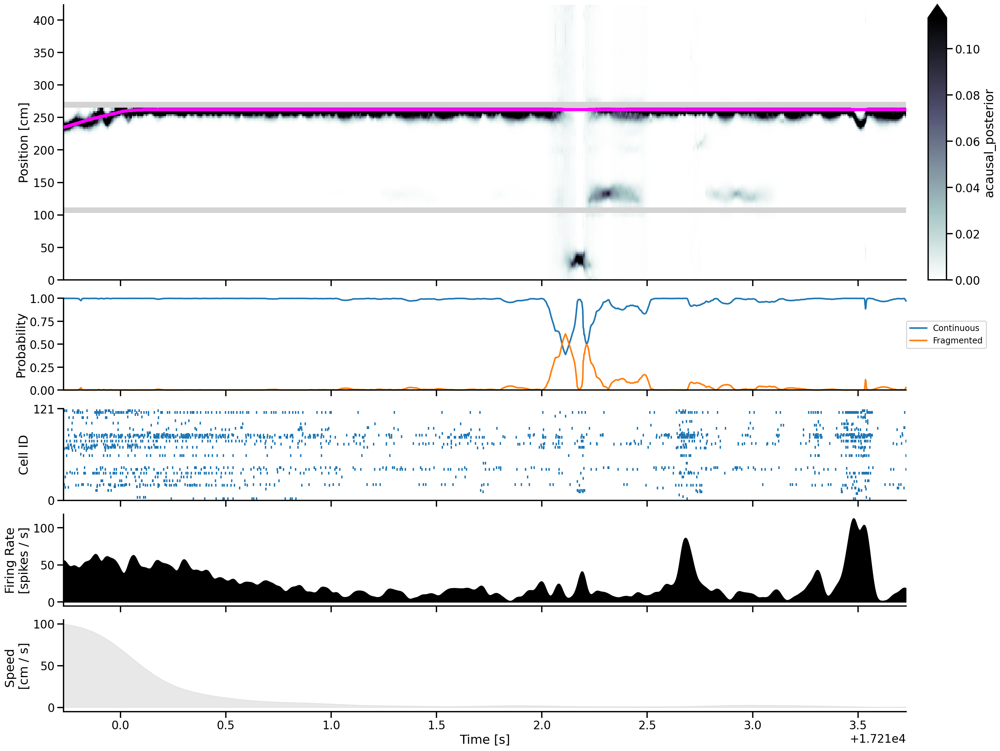

In [22]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(424_000, 426_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

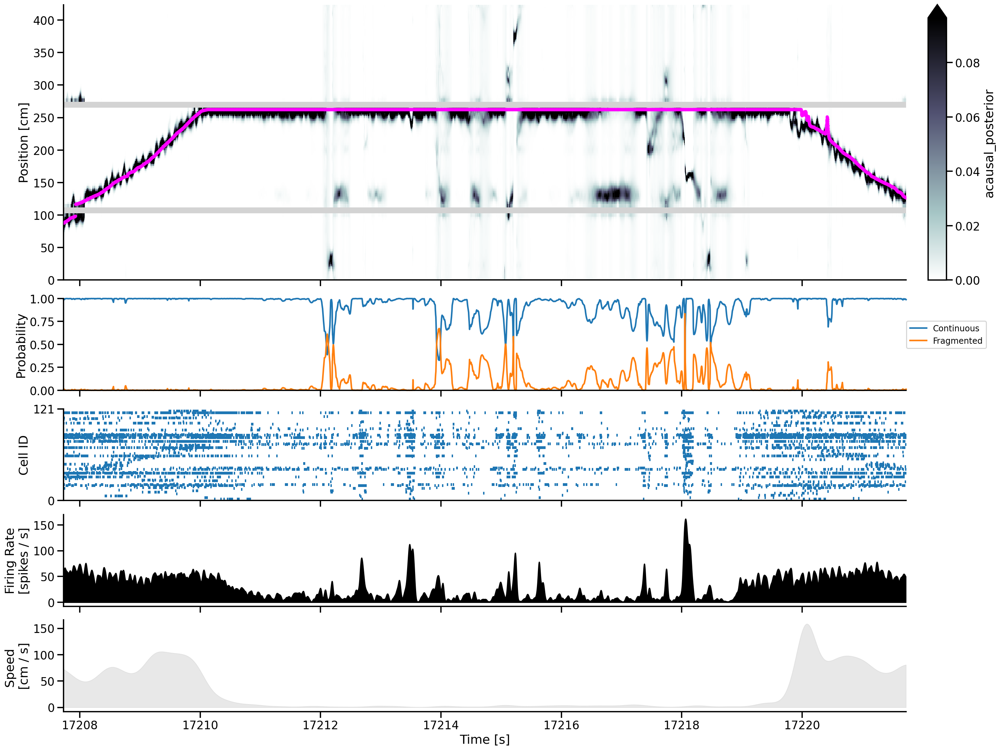

In [24]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(423_000, 430_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

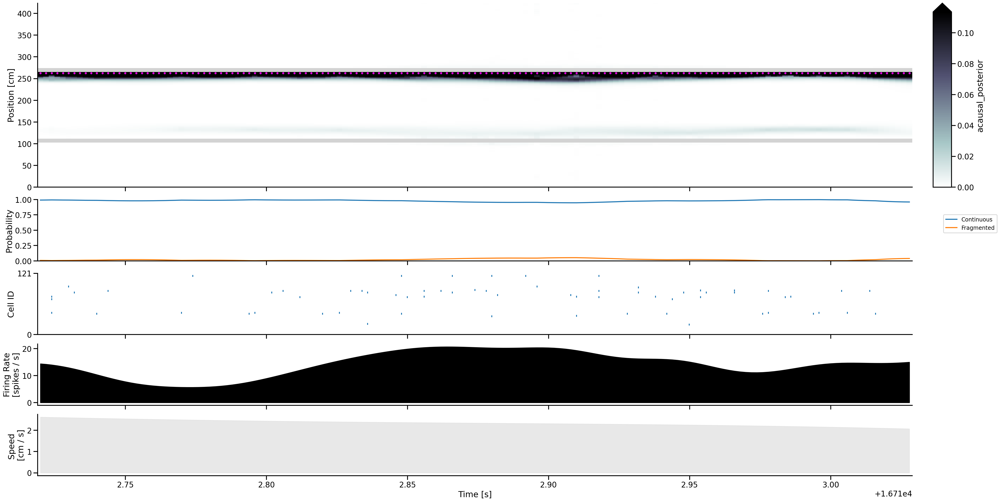

In [25]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(175_495, 175_650)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(30, 15),
    legend=True,
)

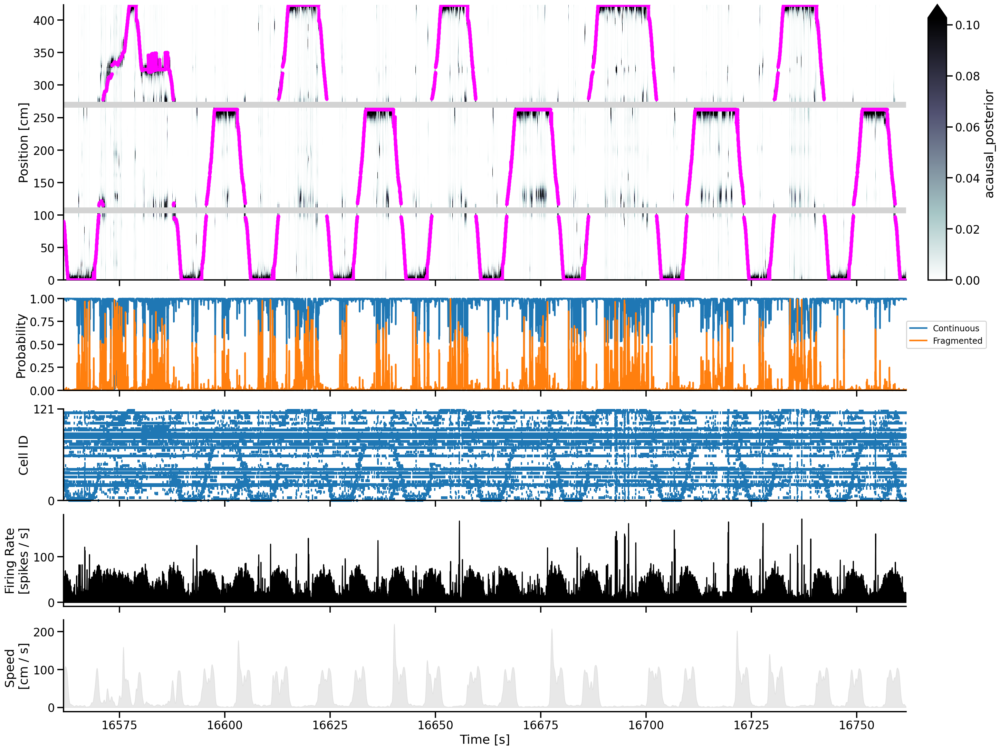

In [44]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(100_000, 200_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

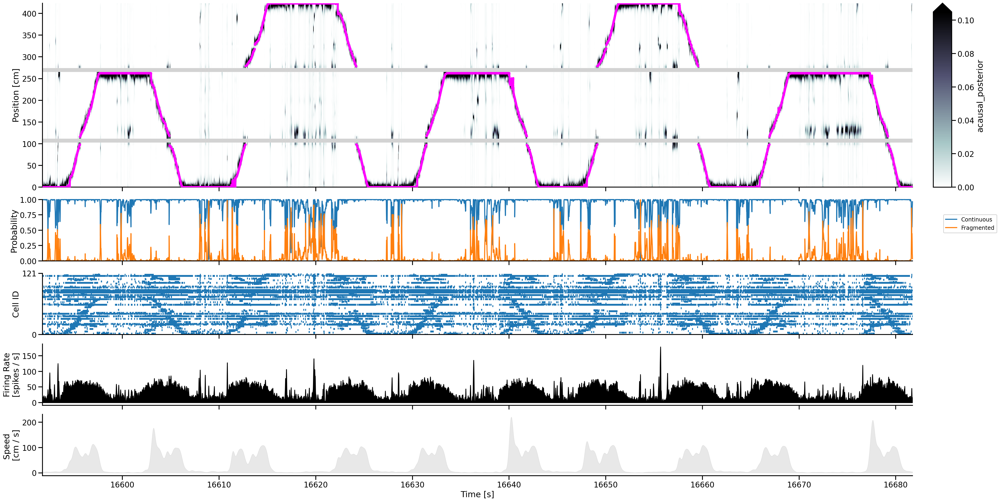

In [27]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(115_000, 160_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(30, 15),
    legend=True,
)

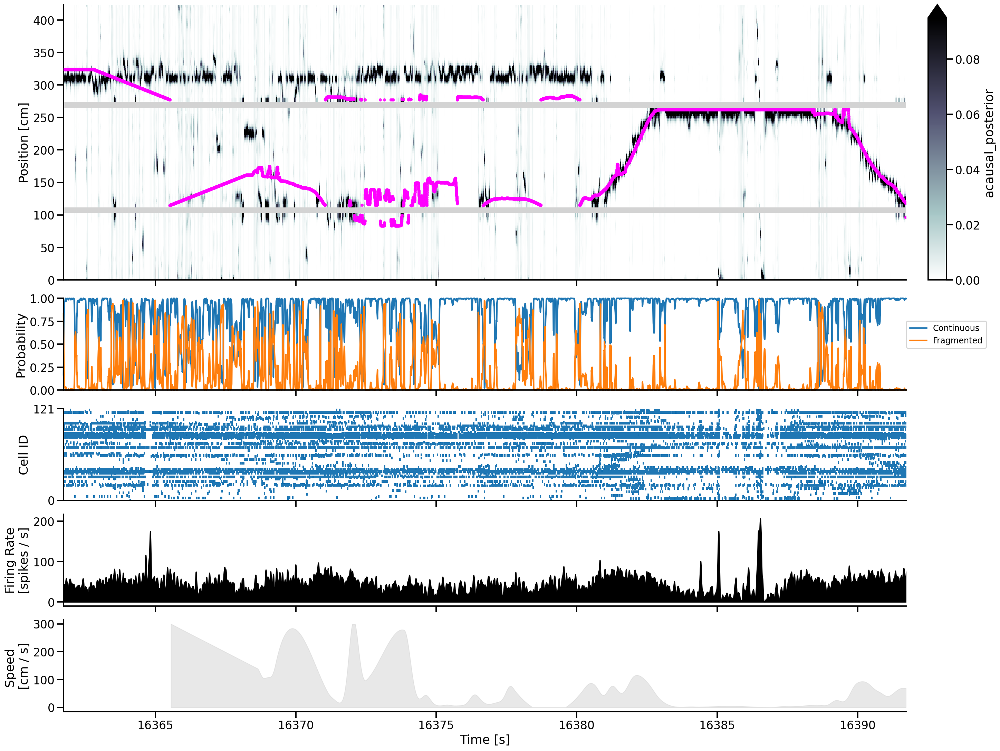

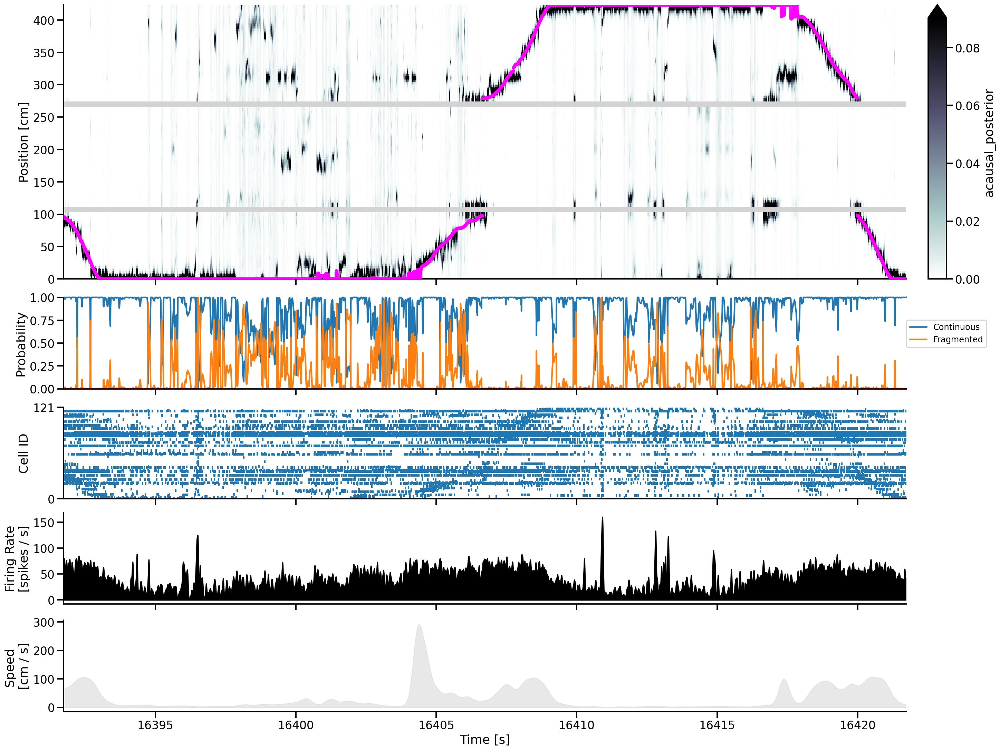

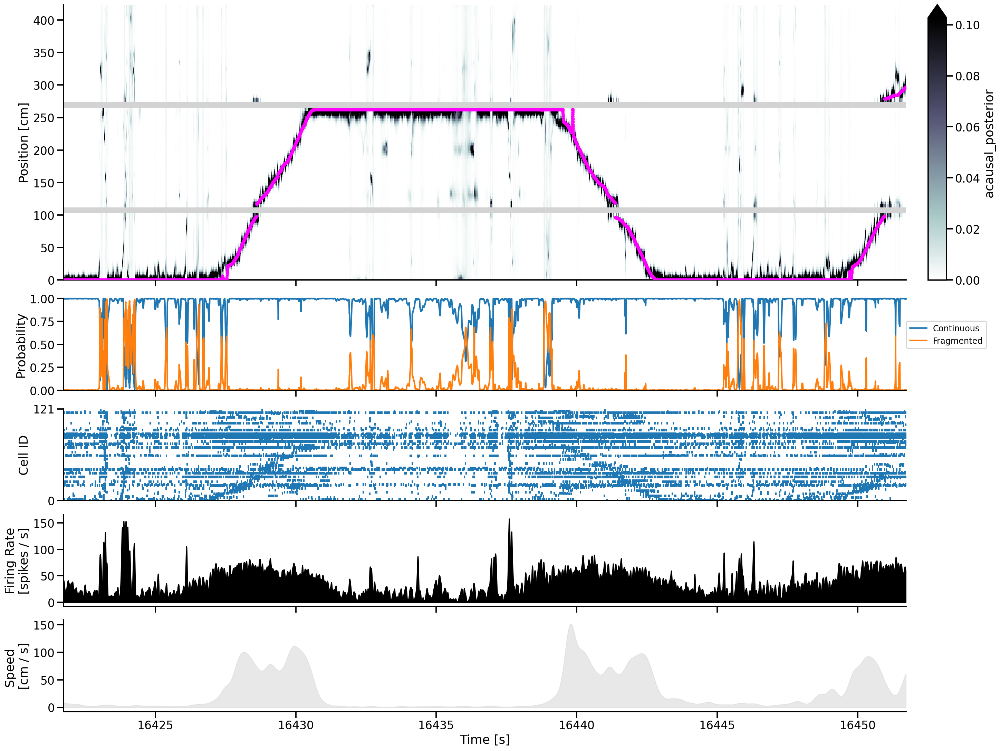

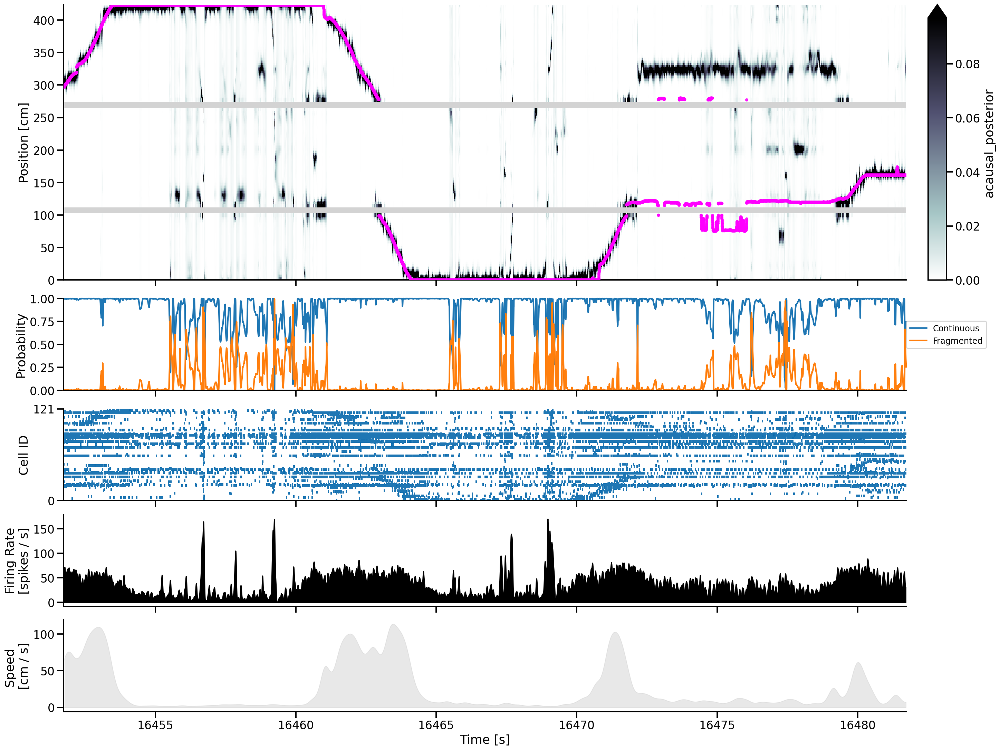

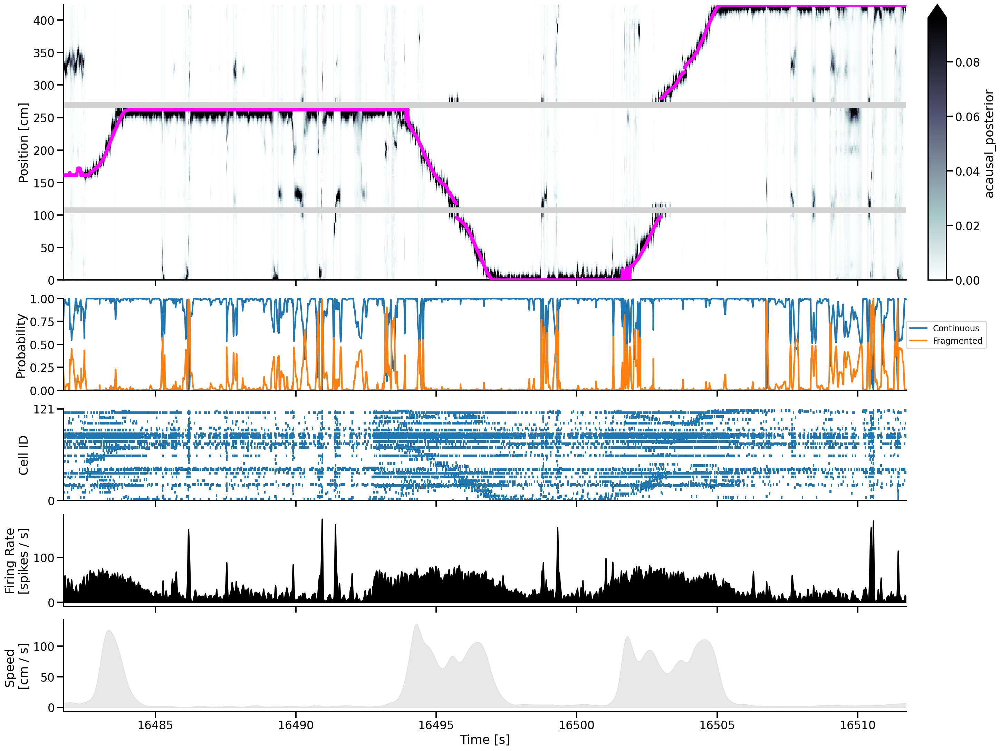

...

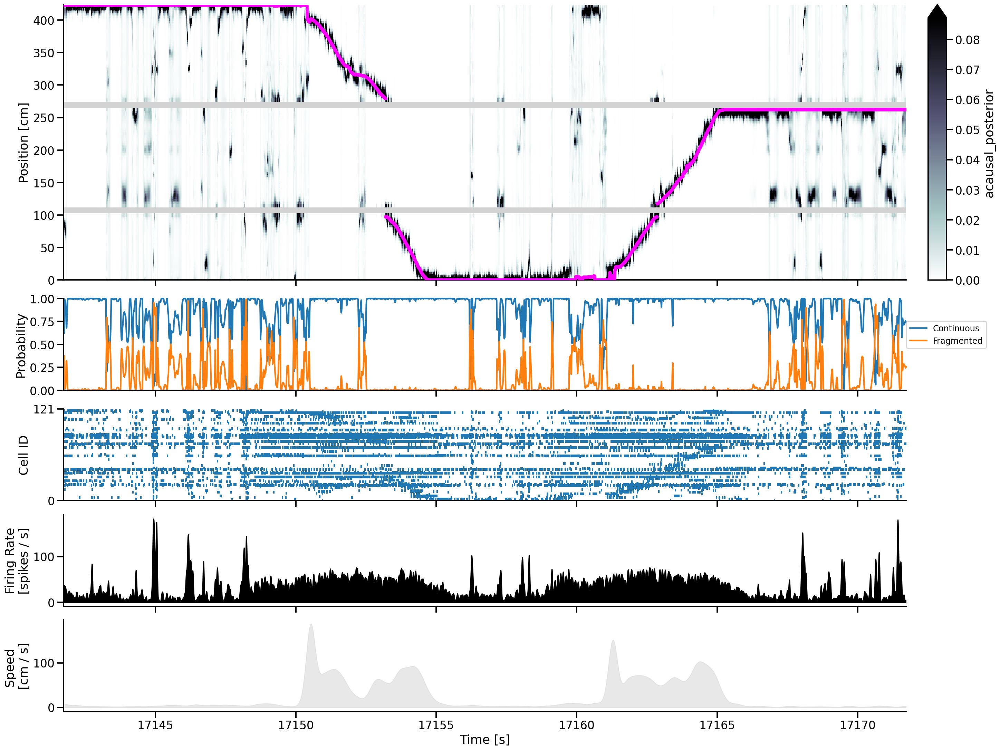

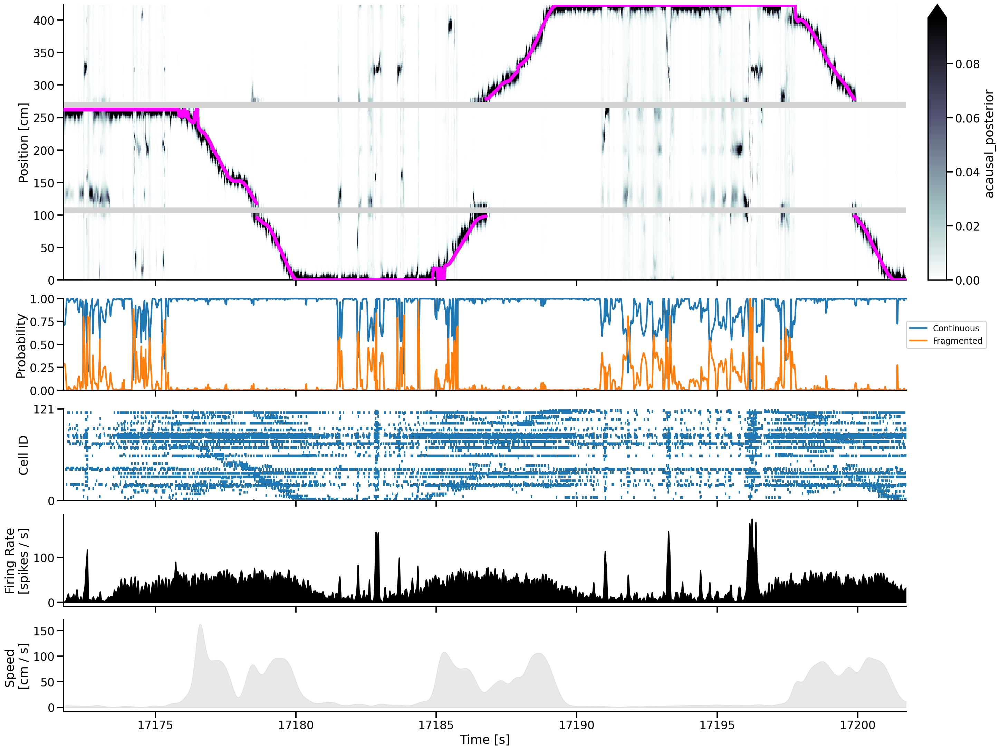

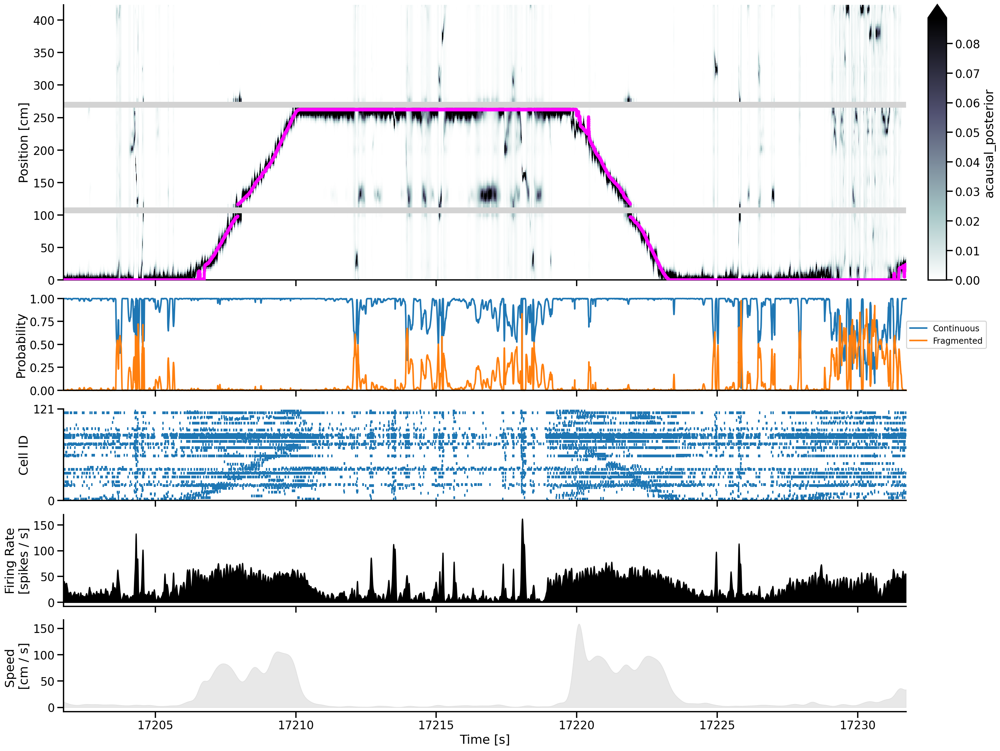

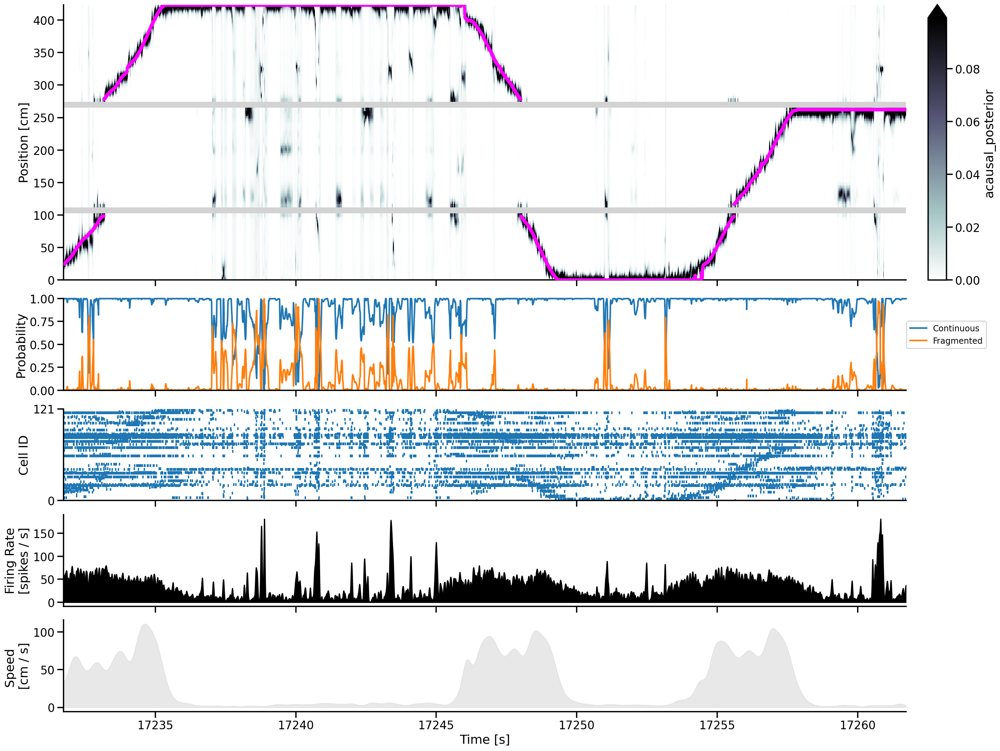

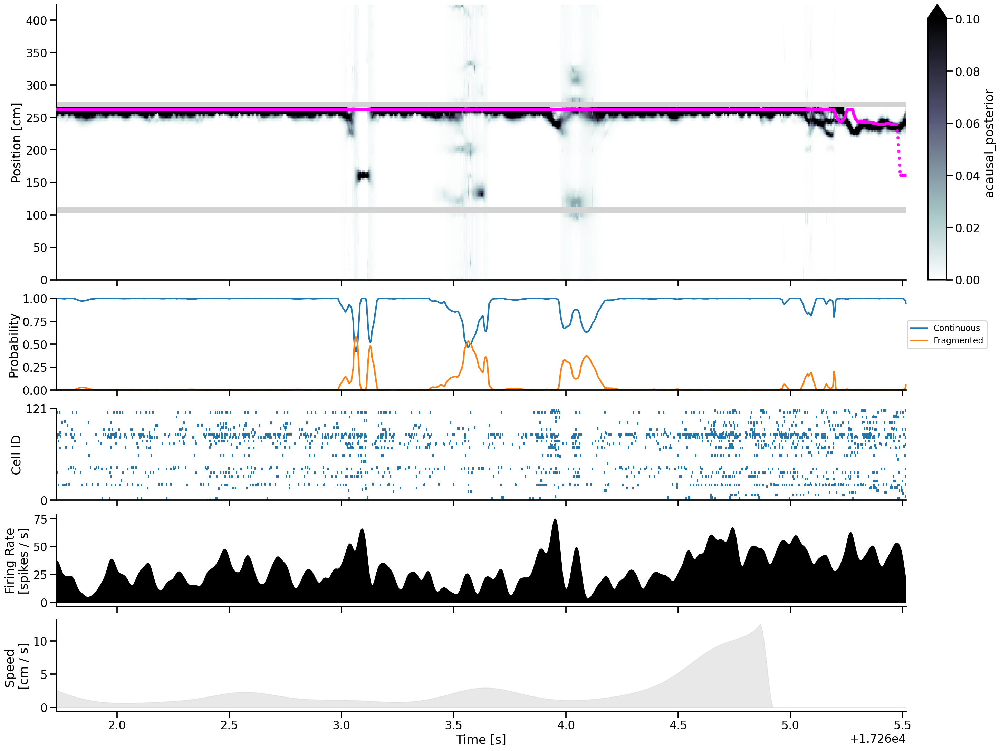

In [30]:
from src.visualization import plot_classifier_spikes

n_time = results.time.shape[0]
time_slice_step = 15_000
time_range = zip(range(0, n_time, time_slice_step),
                 range(time_slice_step, n_time + time_slice_step,
                       time_slice_step))

for start_ind, end_ind in time_range:
    plot_classifier_spikes(
        results.time[slice(start_ind, end_ind)],
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(20, 15),
    )

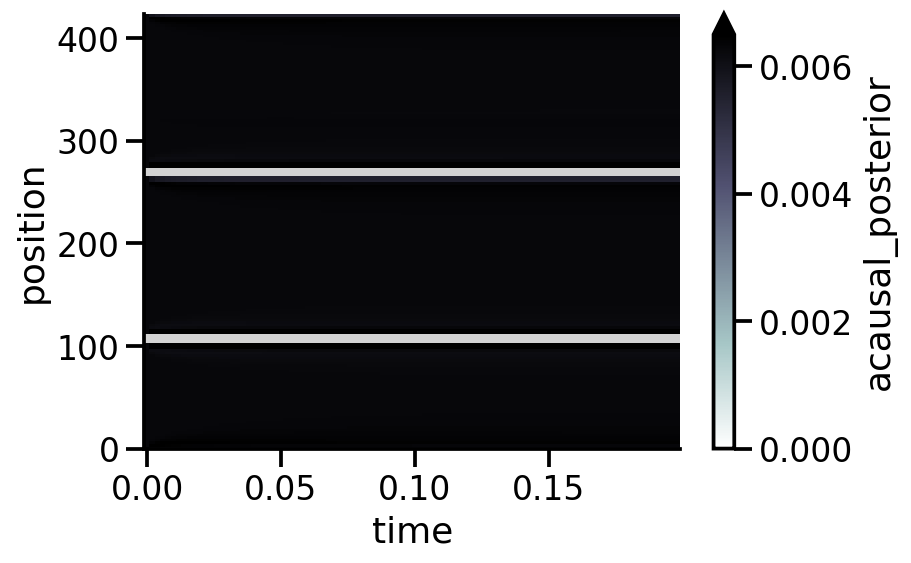

In [32]:
import copy
import matplotlib.pyplot as plt
from src.parameters import SAMPLING_FREQUENCY

n_neurons = data['spikes'].shape[1]
n_time = 100

no_spike_results = (
    predict(
        classifier, 
        np.zeros((n_time, n_neurons)),
        time=np.arange(n_time) / SAMPLING_FREQUENCY,
        state_names=state_names
    )
)

cmap = copy.copy(plt.get_cmap('bone_r'))
cmap.set_bad(color="lightgrey", alpha=1.0)

(no_spike_results
 .acausal_posterior
 .sum('state')
 .where(classifier.is_track_interior_)
 .plot(x='time', y='position', robust=True, vmin=0.0, cmap=cmap))
sns.despine()

Text(0.5, 1.0, 'No Spike Likelihood')

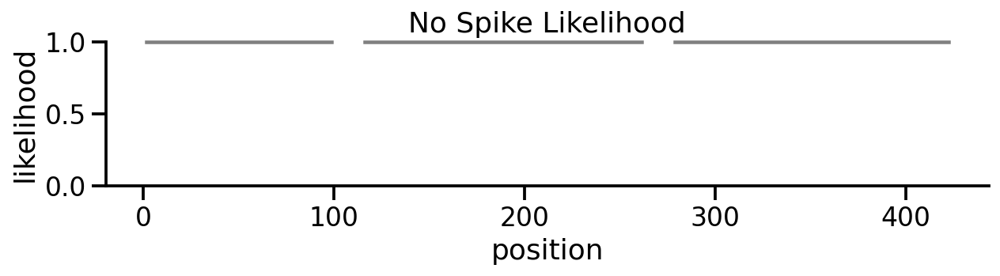

In [43]:
fig, ax = plt.subplots(figsize=(10, 5 / 3))
no_spike_results.likelihood.isel(time=0, state=0).plot(
    x='position', color='grey', clip_on=False, ax=ax)
plt.ylim((0, 1))
sns.despine()
plt.title('No Spike Likelihood')
